**Problem Statement**

*Falls are a major health risk, especially for elderly individuals and people with disabilities. A fall can result in severe injuries, and the lack of immediate assistance can lead to critical conditions. Traditional fall detection methods rely on wearable devices, which may not always be worn or functional. This project aims to develop a computer vision-based Fall Detection System that uses **YOLO, OpenCV, and AI-driven analysis to detect falls and send real-time notifications via WhatsApp**, ensuring timely assistance and reducing health risks.*

**Overview**

*The Fall Detection System is an AI-powered solution that uses **OpenCV, YOLO, Gemini API, and Twilio WhatsApp API** to detect falls and send real-time alerts. This system is designed for applications in elderly care, hospitals, and public safety.*

In [ ]:
#Installing the Required Dependencies

!pip install opencv-python
!pip install numpy
!pip install ultralytics
!pip install mediapipe
!pip install torch
!pip install torchvision
!pip install sympy==1.12

In [ ]:
#Upgrading the ones needed!

!pip install torch torchvision torchaudio --upgrade
!pip install ultralytics --upgrade

In [ ]:
#Importing the Installed Dependencies

import cv2
import numpy as np
import mediapipe as mp
import torch
from ultralytics import YOLO
from google.colab.patches import cv2_imshow
from google.colab import drive

**Testing with pre recorded videos for simplicity**

Please Note: Real-time webcame usage is also possible

*video 1 - [Marathon Athlete falling down](https://drive.google.com/file/d/1eIsSKr1jp85lLP84UBlCfM5-jOPdCd73/view?usp=drive_link)*

*video 2 - [Professor falling and spilling papers](https://drive.google.com/file/d/1irbs5EU_9Unz8M3cH8qM9w9-TWJBubQ2/view?usp=sharing)*

*video 3 - [Roller Scater clattering against a pole, falling inconscious](https://drive.google.com/file/d/13O-rzEjSv0frDOc9NvvX_ke1XT33ve2l/view?usp=drive_link)*

*video 4 - [Factory worker falling down, hurting his back](https://drive.google.com/file/d/1fbQAV5_BLrBf516rv---E9m4auACoDeB/view?usp=sharing)*

*video 5 - [Man slipping while bowling, falling down backwards](https://drive.google.com/file/d/1hungDMuZSoU-_9cEqmIugkjvxVKNkIvq/view?usp=sharing)*

*video 6 - [SkateBoard player falls down during skating!](https://drive.google.com/file/d/1zkpQB4EF9SKbPaRFQIXiDWaZMtI5XwxS/view?usp=sharing)*

In [ ]:
video_path1  = "https://drive.google.com/file/d/1eIsSKr1jp85lLP84UBlCfM5-jOPdCd73/view?usp=drive_link"
video_path2  = "https://drive.google.com/file/d/1irbs5EU_9Unz8M3cH8qM9w9-TWJBubQ2/view?usp=drive_link"
video_path3  = "https://drive.google.com/file/d/13O-rzEjSv0frDOc9NvvX_ke1XT33ve2l/view?usp=drive_link"
video_path4  = "https://drive.google.com/file/d/1fbQAV5_BLrBf516rv---E9m4auACoDeB/view?usp=drive_link"
video_path5  = "https://drive.google.com/file/d/1hungDMuZSoU-_9cEqmIugkjvxVKNkIvq/view?usp=drive_link"
video_path6  = "https://drive.google.com/file/d/1zkpQB4EF9SKbPaRFQIXiDWaZMtI5XwxS/view?usp=drive_link"

In [ ]:
# Bringing in some color
!pip install colorama

In [ ]:
#Asking user for an input
from colorama import Fore, Back, Style
def choose_vid():
  print("These are your following choices")
  choices = {1:"Marathon Athlete falling down",               #Using a Dictionary for the choices
             2:"Professor falling and spilling papers",
             3:"Roller Scater limping against a pole, falling inconscious",
             4:"Factory worker falling down, hurting his back",
             5:"Man slipping while bowling, falling down backwards",
             6:"SkateBoard player falls down during skating"}

  for key,value in choices.items():
    k =str(key)
    v= str(value)
    print(Fore.GREEN + k + " " + v)
  ch=int(input("Enter your choice"))

  print(Fore.RED + "Selected choice")

  print(choices[ch])

  return ch

choice=choose_vid()

These are your following choices
1 Marathon Athlete falling down
2 Professor falling and spilling papers
3 Roller Scater limping against a pole, falling inconscious
4 Factory worker falling down, hurting his back
5 Man slipping while bowling, falling down backwards
6 SkateBoard player falls down during skating
Enter your choice6
Selected choice
SkateBoard player falls down during skating


In [ ]:
#Mapping path to the video
video_paths = {1:video_path1,               #Using a Dictionary for the choices
             2:video_path2,
             3:video_path3,
             4:video_path4,
             5:video_path5,
             6:video_path6}

for i in range(6):
  if (i+1)==choice:
    video_path=video_paths[i+1]
    break;

print(video_path)

https://drive.google.com/file/d/1zkpQB4EF9SKbPaRFQIXiDWaZMtI5XwxS/view?usp=drive_link


In [ ]:
#Dependecies installation for playing the video selected

!pip install -U kora

In [ ]:
#Extracting the File ID

import re

# Example Google Drive URL
drive_link = video_path

# Extract the file ID using regex
match = re.search(r'/d/([a-zA-Z0-9_-]+)', drive_link)
if match:
    file_id = match.group(1)
    print("Extracted File ID:", file_id)
else:
    print("Invalid Google Drive link")


Extracted File ID: 1zkpQB4EF9SKbPaRFQIXiDWaZMtI5XwxS


In [ ]:
import gdown
from IPython.display import HTML
from base64 import b64encode


video_file_id = file_id # Extracted from the link


video_path = "fall_video.mp4"
gdrive_url = f"https://drive.google.com/uc?id={file_id}"

#Locally downloading the video
gdown.download(gdrive_url, video_path, quiet=False)

# Reading and displaying the video
mp4 = open(video_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
print(Fore.BLUE+ Back.YELLOW  + "This is the requested video")

HTML(f'<video width="600" height="450" controls><source src="{data_url}" type="video/mp4"></video>')



Downloading...
From: https://drive.google.com/uc?id=1zkpQB4EF9SKbPaRFQIXiDWaZMtI5XwxS
To: /content/fall_video.mp4
100%|██████████| 350k/350k [00:00<00:00, 6.07MB/s]

This is the requested video


**As of Now, The File Imports are working Fine and the video is being displayed**

**Next Up, the the model creation comes up**


In [ ]:
#Video Capturing
cap = cv2.VideoCapture(video_path)

# Load YOLO Model
model = YOLO("yolov8n.pt")

# Initialize MediaPipe Pose Estimation
mp_pose = mp.solutions.pose
pose = mp_pose.Pose()

In [ ]:
!pip install cvzone


0: 384x640 3 persons, 222.7ms
Speed: 4.0ms preprocess, 222.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


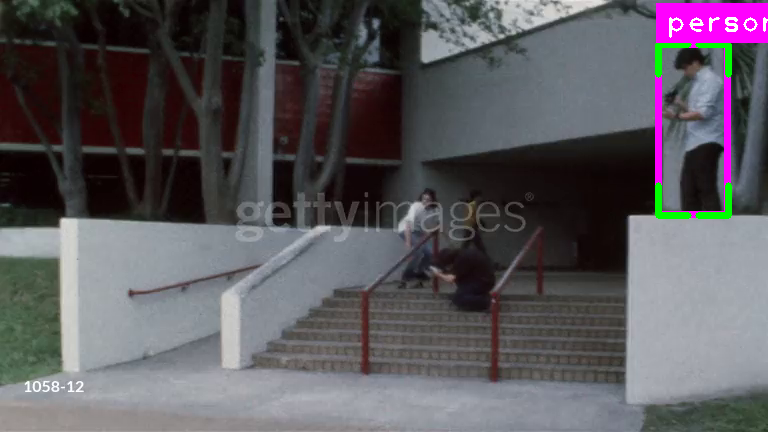


0: 384x640 3 persons, 228.7ms
Speed: 3.7ms preprocess, 228.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


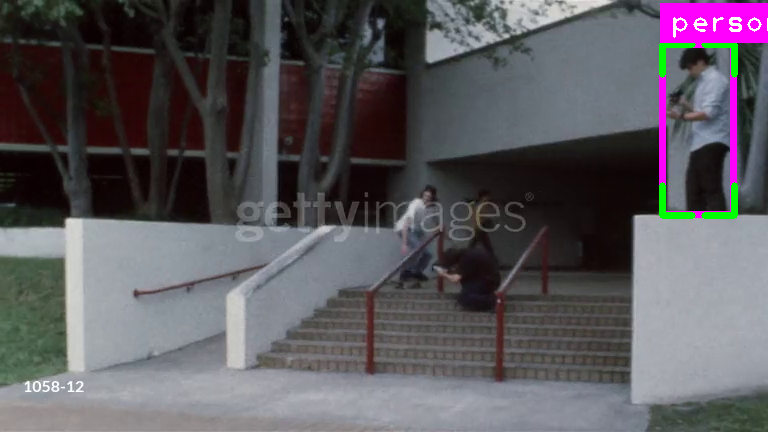


0: 384x640 3 persons, 202.0ms
Speed: 4.2ms preprocess, 202.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


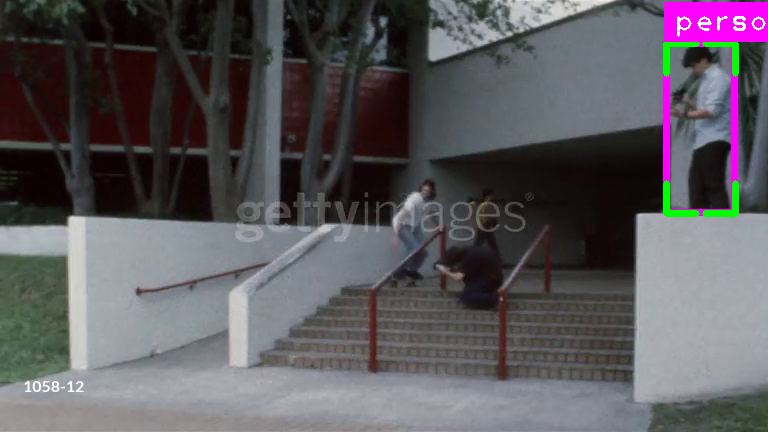


0: 384x640 3 persons, 194.7ms
Speed: 4.0ms preprocess, 194.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


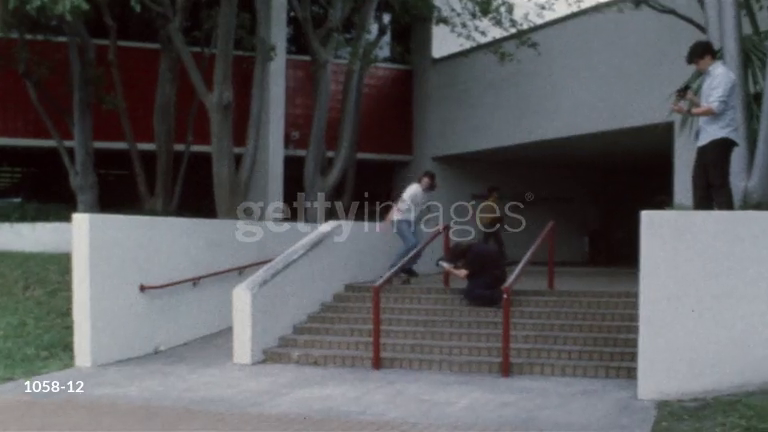


0: 384x640 3 persons, 252.5ms
Speed: 3.9ms preprocess, 252.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


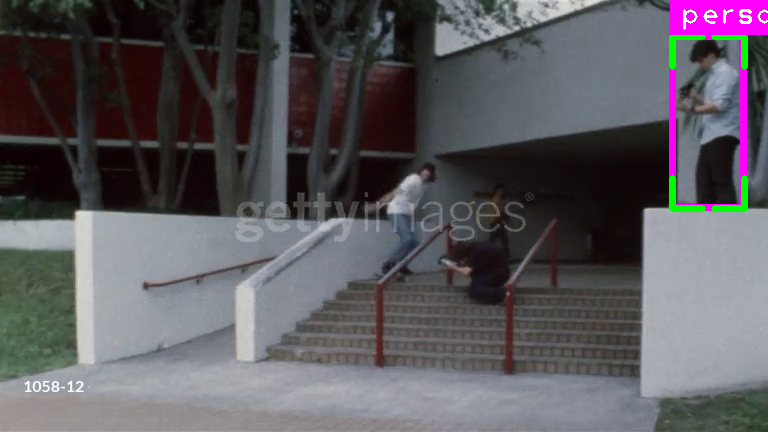


0: 384x640 4 persons, 1 skateboard, 341.2ms
Speed: 8.2ms preprocess, 341.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


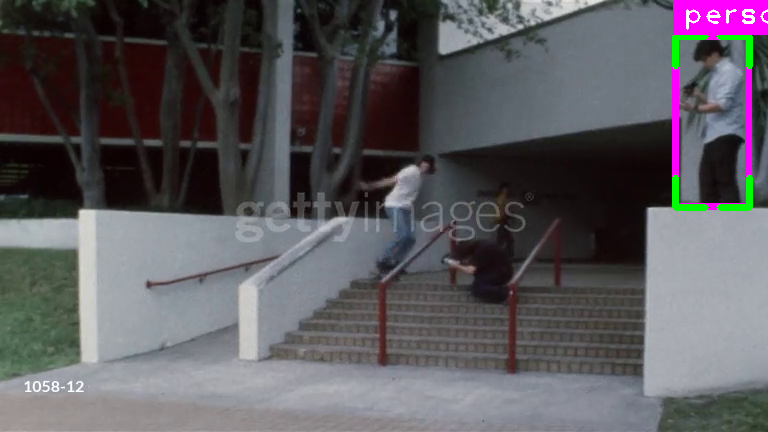


0: 384x640 3 persons, 264.5ms
Speed: 3.7ms preprocess, 264.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


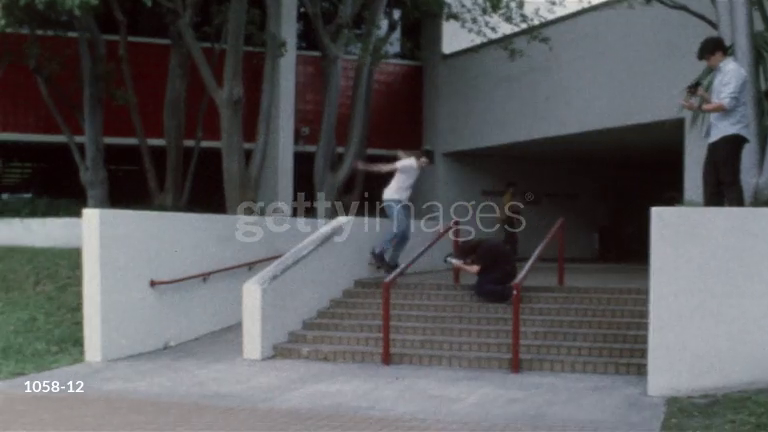


0: 384x640 3 persons, 425.3ms
Speed: 4.0ms preprocess, 425.3ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


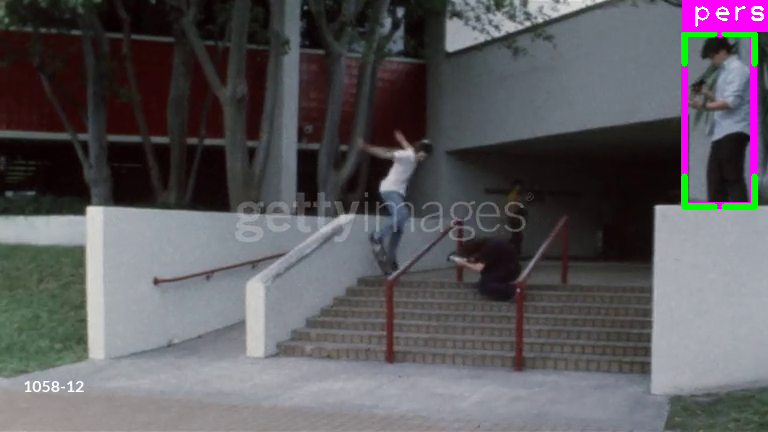


0: 384x640 3 persons, 250.6ms
Speed: 6.1ms preprocess, 250.6ms inference, 4.3ms postprocess per image at shape (1, 3, 384, 640)


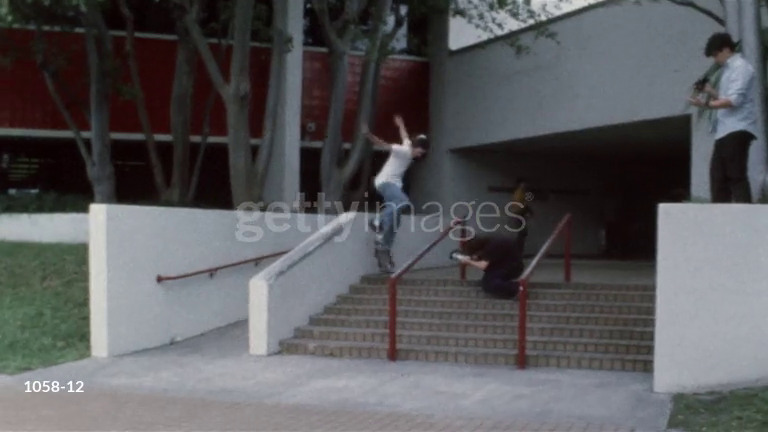


0: 384x640 2 persons, 409.8ms
Speed: 3.8ms preprocess, 409.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


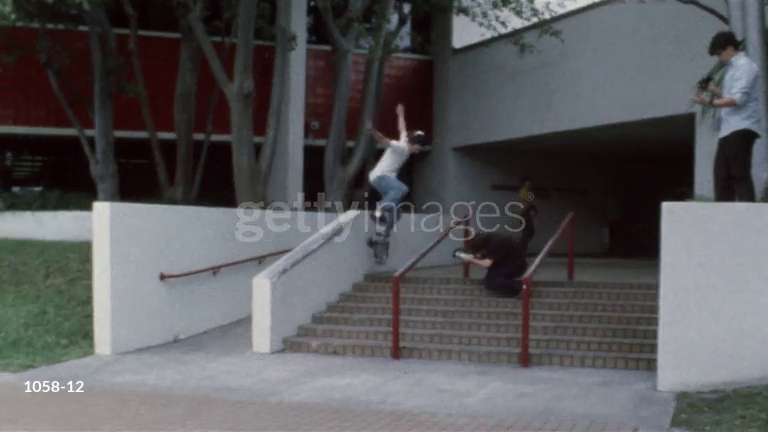


0: 384x640 3 persons, 338.1ms
Speed: 3.8ms preprocess, 338.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


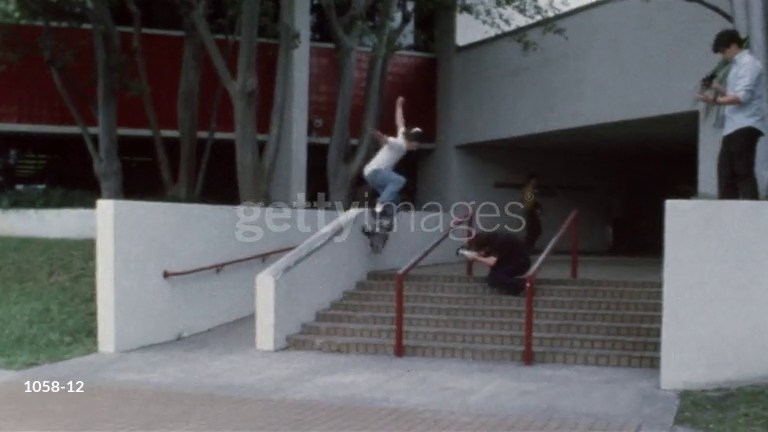


0: 384x640 2 persons, 1 refrigerator, 461.9ms
Speed: 4.0ms preprocess, 461.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


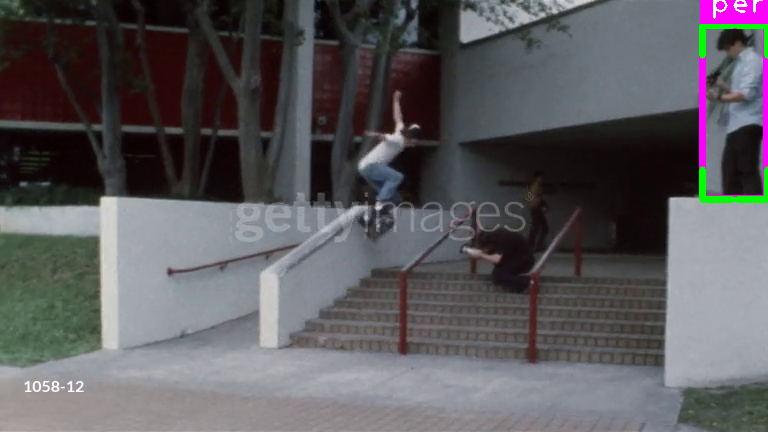


0: 384x640 2 persons, 591.1ms
Speed: 7.9ms preprocess, 591.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


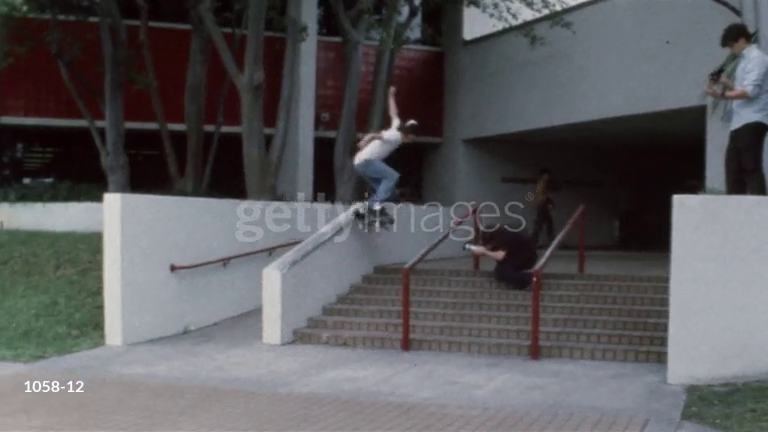


0: 384x640 2 persons, 768.5ms
Speed: 11.4ms preprocess, 768.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


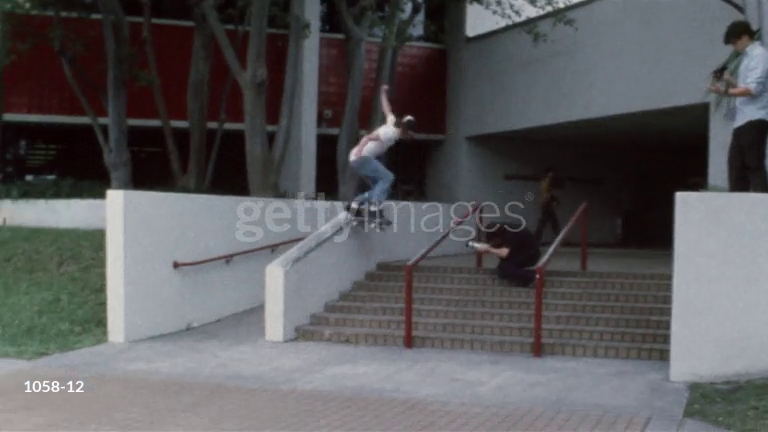


0: 384x640 2 persons, 2 skateboards, 255.3ms
Speed: 4.7ms preprocess, 255.3ms inference, 9.9ms postprocess per image at shape (1, 3, 384, 640)


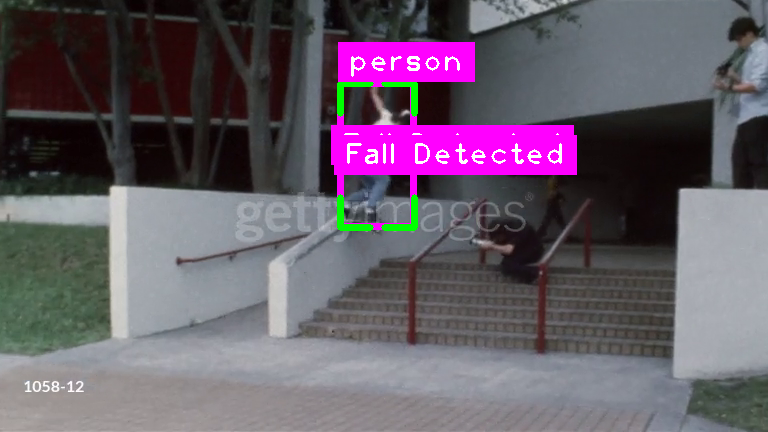


0: 384x640 2 persons, 2 skateboards, 611.2ms
Speed: 15.0ms preprocess, 611.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


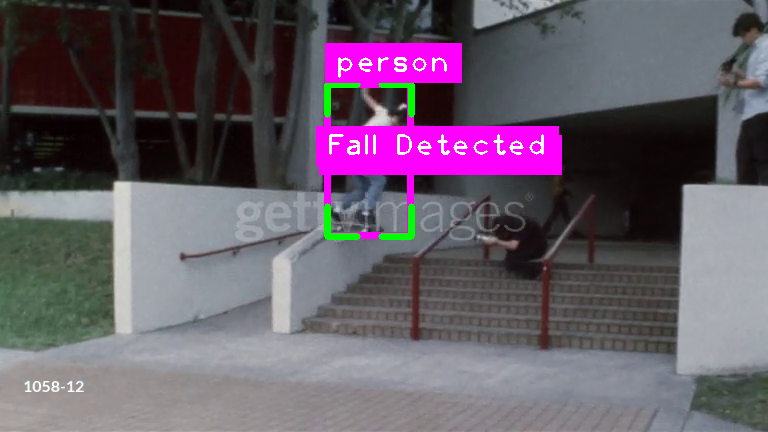


0: 384x640 3 persons, 552.8ms
Speed: 11.5ms preprocess, 552.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


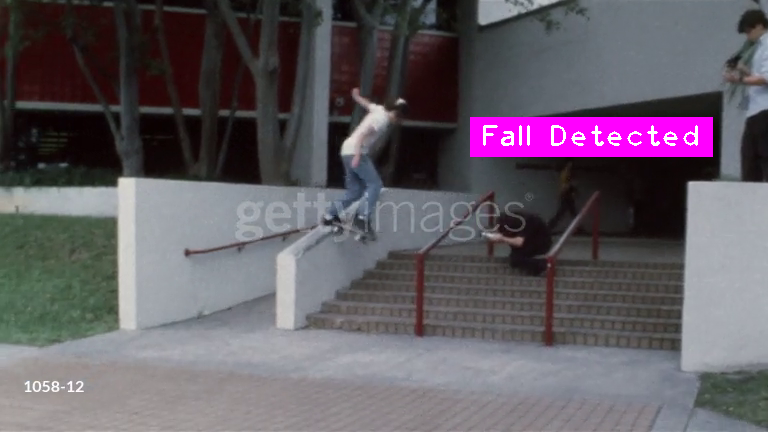


0: 384x640 3 persons, 399.1ms
Speed: 7.6ms preprocess, 399.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


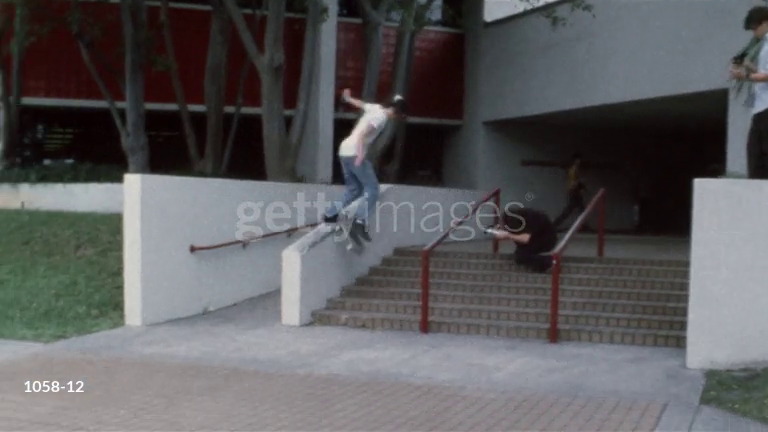


0: 384x640 2 persons, 507.8ms
Speed: 4.0ms preprocess, 507.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


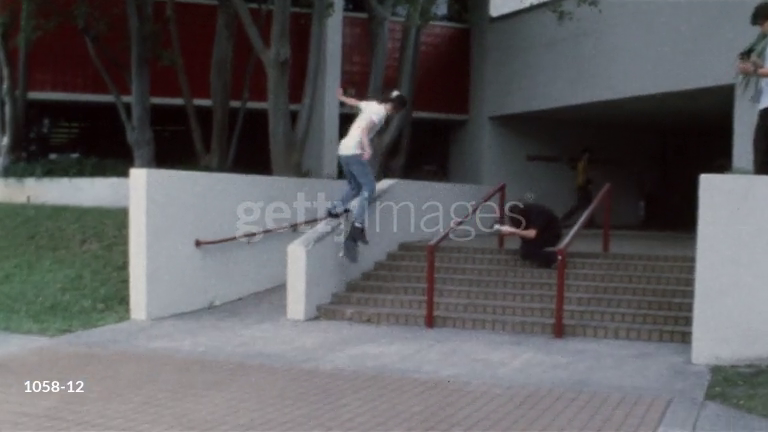


0: 384x640 1 person, 1 refrigerator, 439.3ms
Speed: 7.0ms preprocess, 439.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


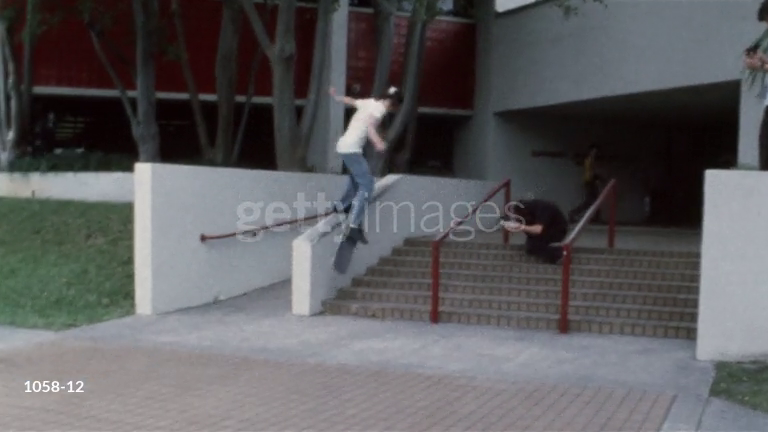


0: 384x640 1 person, 697.7ms
Speed: 7.0ms preprocess, 697.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


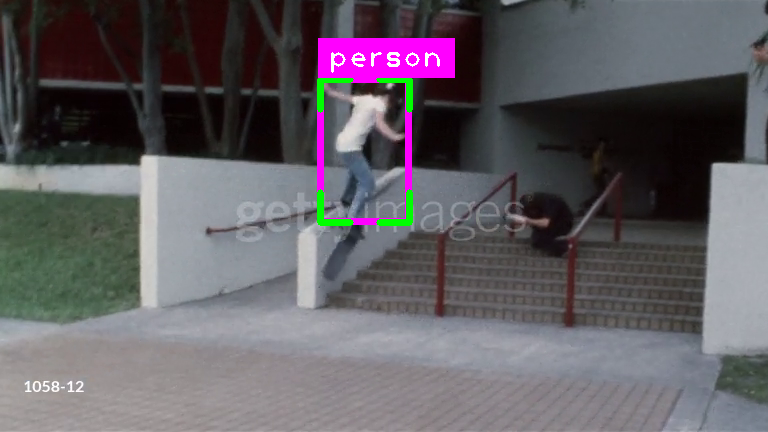


0: 384x640 (no detections), 637.4ms
Speed: 12.1ms preprocess, 637.4ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


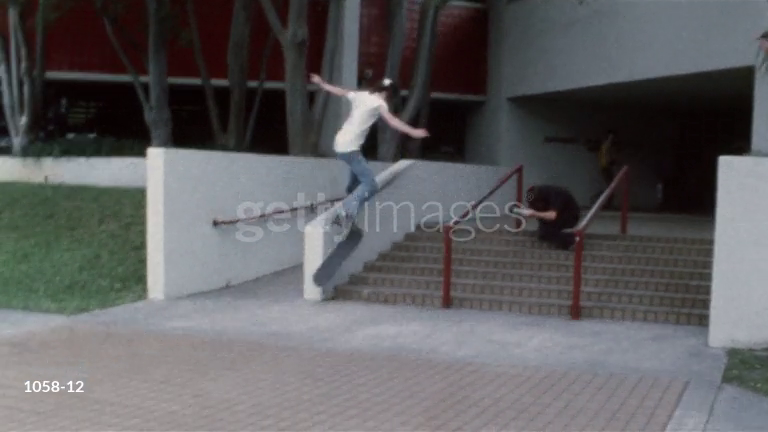


0: 384x640 1 person, 461.4ms
Speed: 3.8ms preprocess, 461.4ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


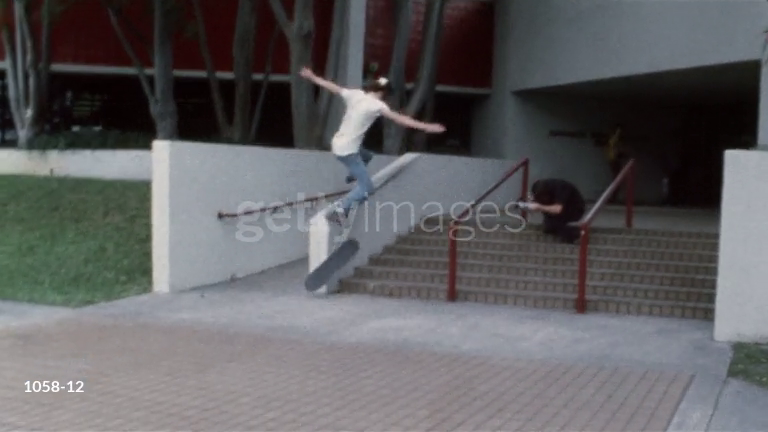


0: 384x640 2 persons, 787.5ms
Speed: 17.9ms preprocess, 787.5ms inference, 16.7ms postprocess per image at shape (1, 3, 384, 640)


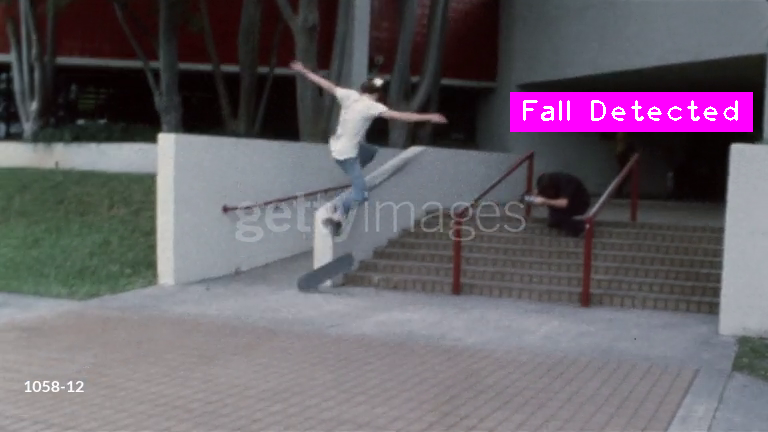


0: 384x640 2 persons, 743.0ms
Speed: 20.4ms preprocess, 743.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


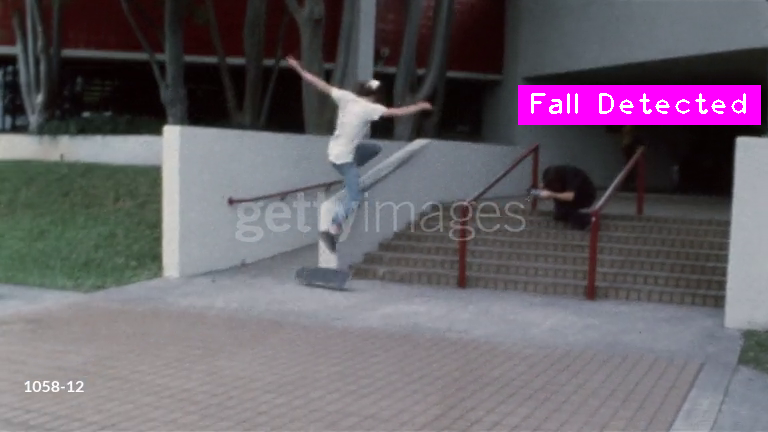


0: 384x640 2 persons, 703.4ms
Speed: 3.7ms preprocess, 703.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


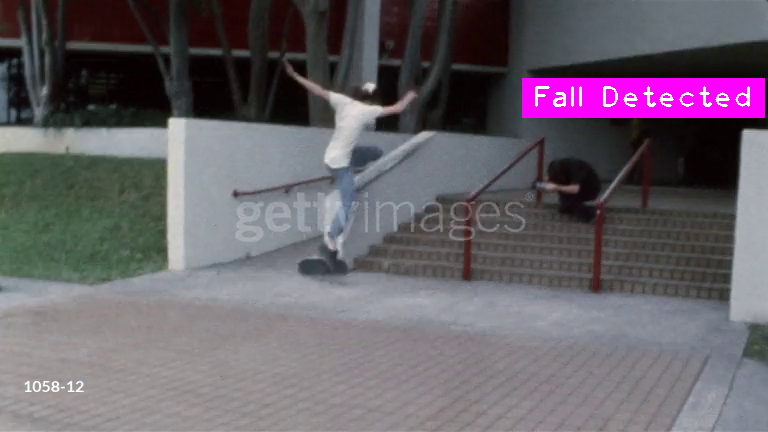


0: 384x640 2 persons, 1 skateboard, 644.0ms
Speed: 29.9ms preprocess, 644.0ms inference, 4.9ms postprocess per image at shape (1, 3, 384, 640)


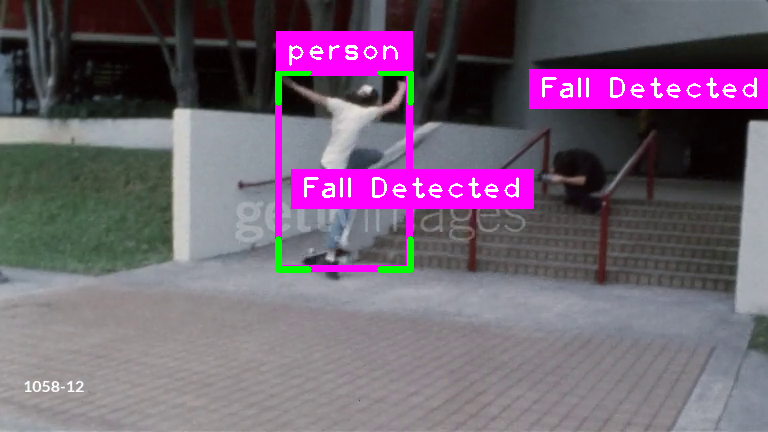


0: 384x640 2 persons, 453.0ms
Speed: 3.8ms preprocess, 453.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


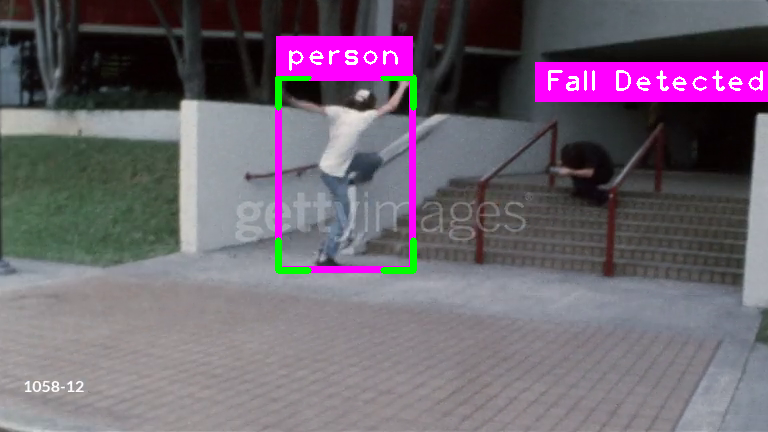


0: 384x640 2 persons, 583.6ms
Speed: 3.7ms preprocess, 583.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


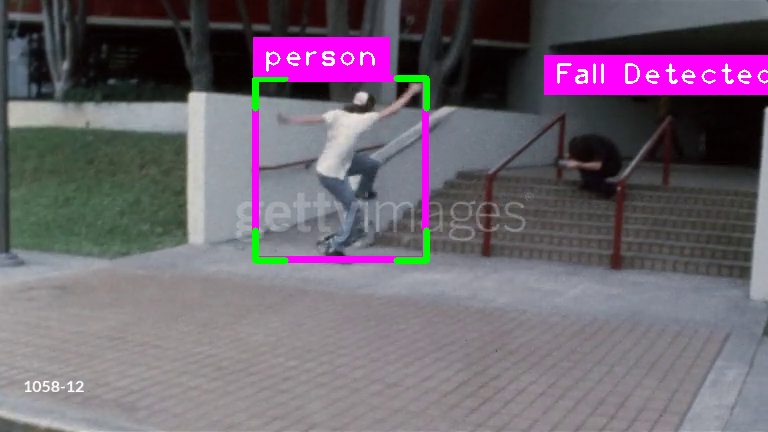


0: 384x640 2 persons, 538.4ms
Speed: 21.0ms preprocess, 538.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


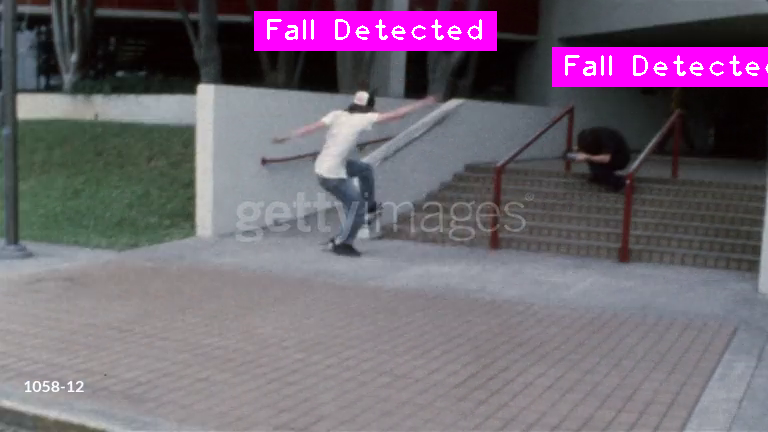


0: 384x640 1 person, 375.0ms
Speed: 3.9ms preprocess, 375.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


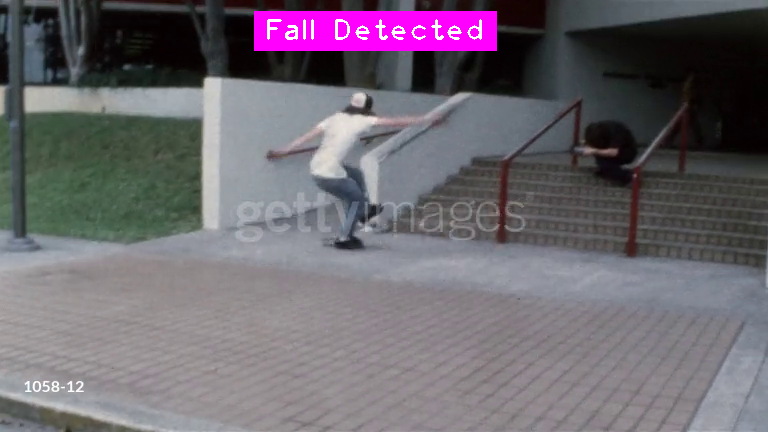


0: 384x640 1 person, 1 skateboard, 473.1ms
Speed: 4.9ms preprocess, 473.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


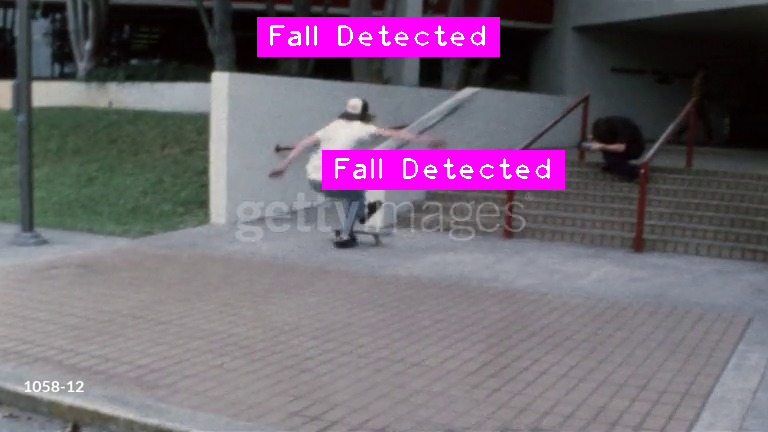


0: 384x640 1 person, 722.9ms
Speed: 8.7ms preprocess, 722.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


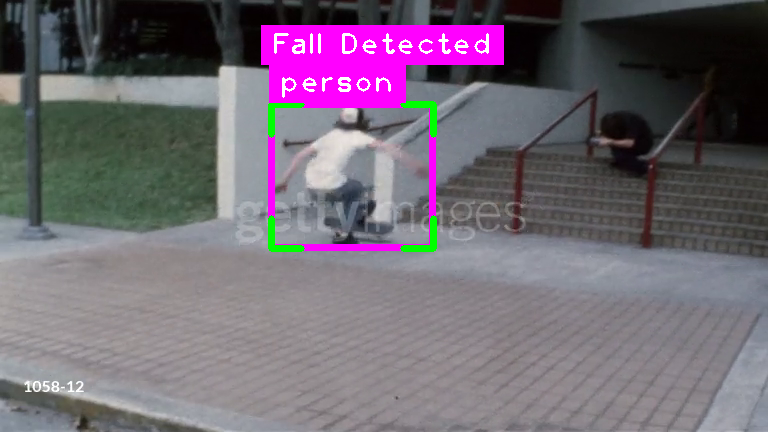


0: 384x640 1 person, 505.4ms
Speed: 6.0ms preprocess, 505.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


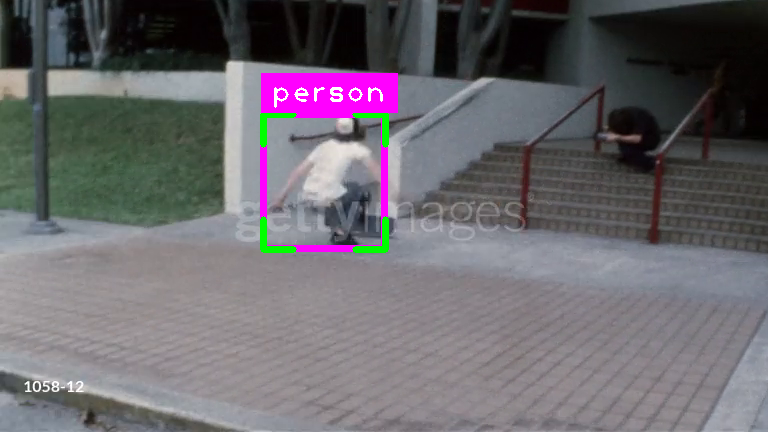


0: 384x640 2 persons, 702.2ms
Speed: 4.9ms preprocess, 702.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


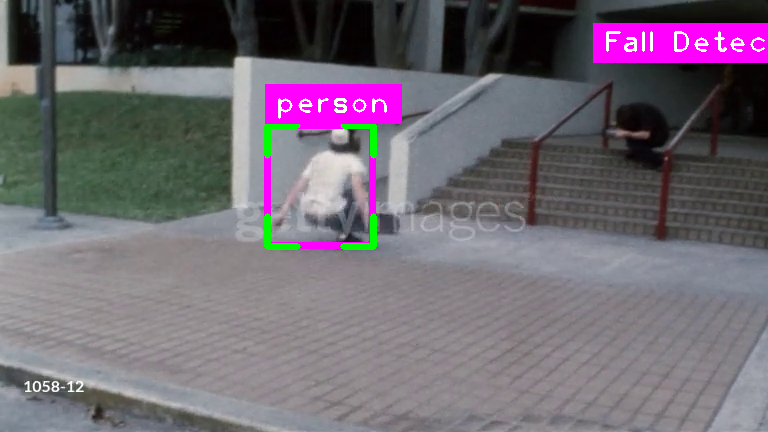


0: 384x640 2 persons, 770.3ms
Speed: 4.8ms preprocess, 770.3ms inference, 9.2ms postprocess per image at shape (1, 3, 384, 640)


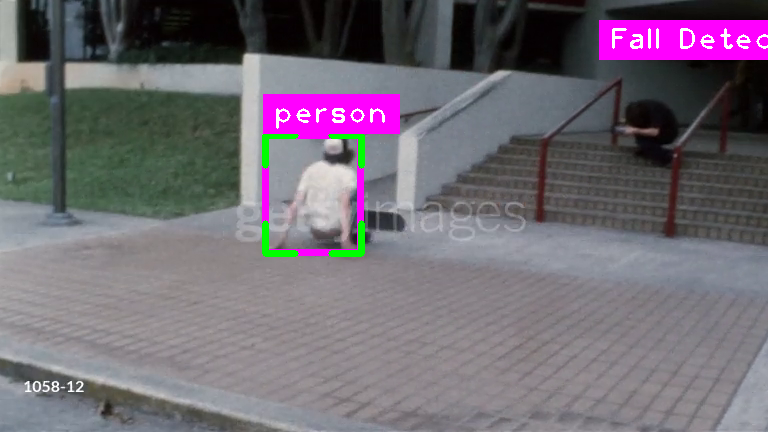


0: 384x640 1 person, 362.7ms
Speed: 7.2ms preprocess, 362.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


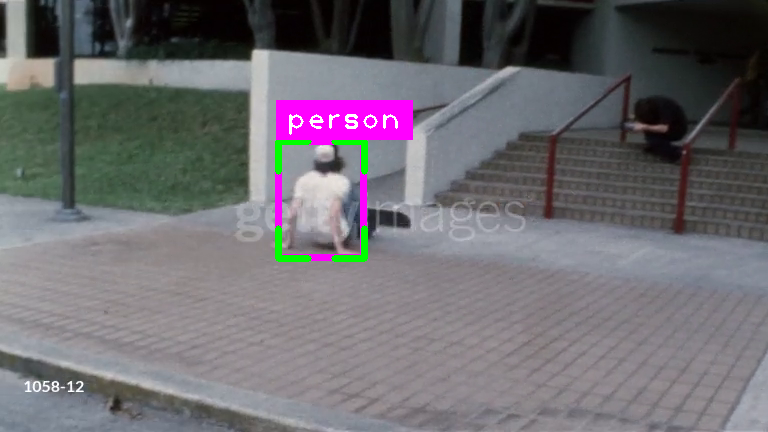


0: 384x640 1 person, 213.8ms
Speed: 4.0ms preprocess, 213.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


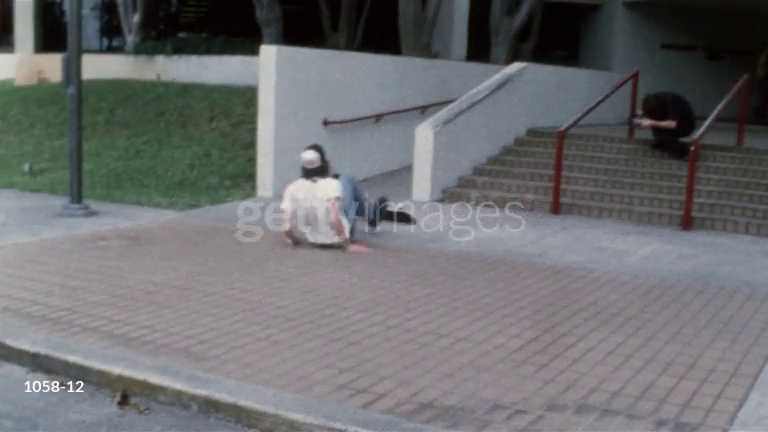


0: 384x640 1 person, 194.6ms
Speed: 4.0ms preprocess, 194.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


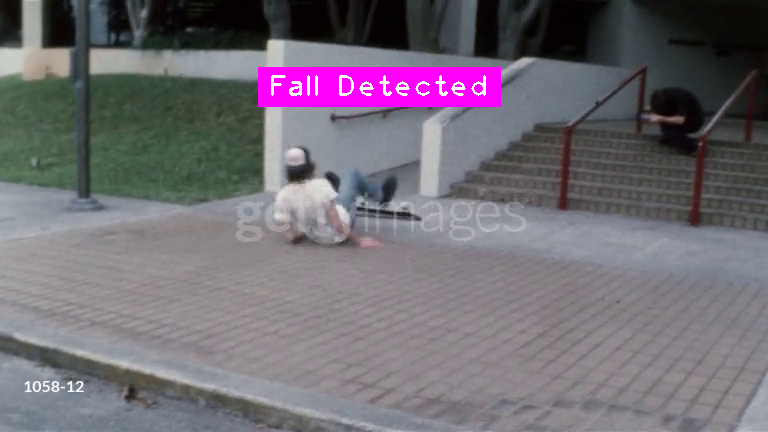


0: 384x640 2 persons, 216.3ms
Speed: 4.4ms preprocess, 216.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


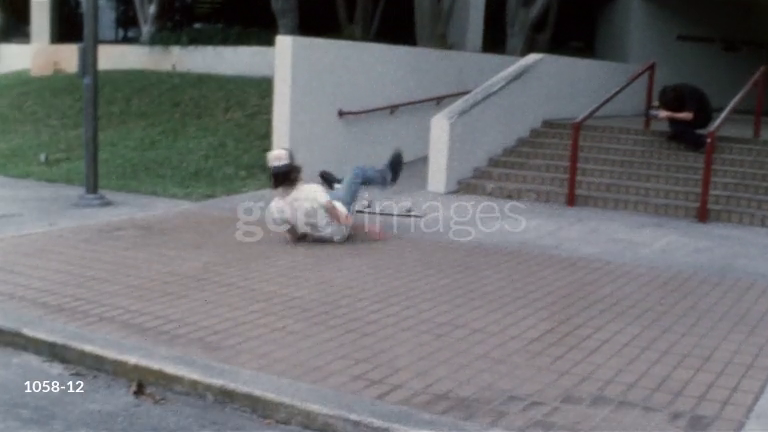


0: 384x640 1 person, 1 bird, 193.2ms
Speed: 4.2ms preprocess, 193.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


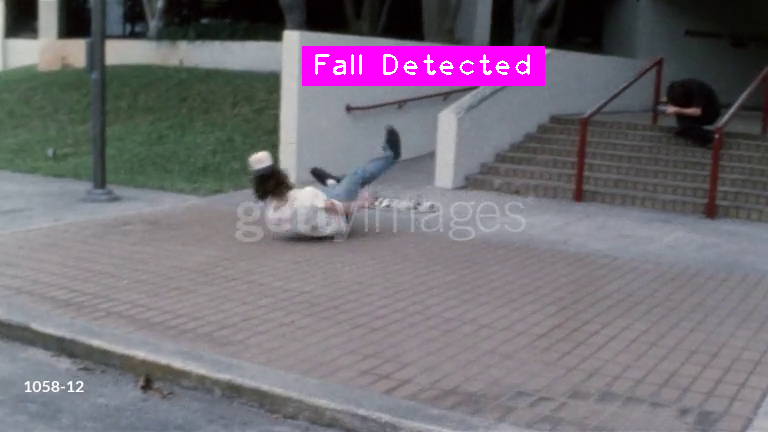


0: 384x640 (no detections), 192.3ms
Speed: 6.2ms preprocess, 192.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


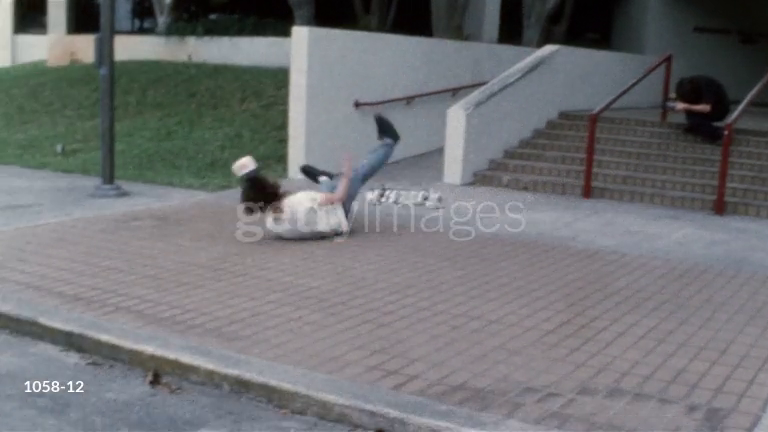


0: 384x640 1 person, 1 airplane, 193.3ms
Speed: 4.2ms preprocess, 193.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


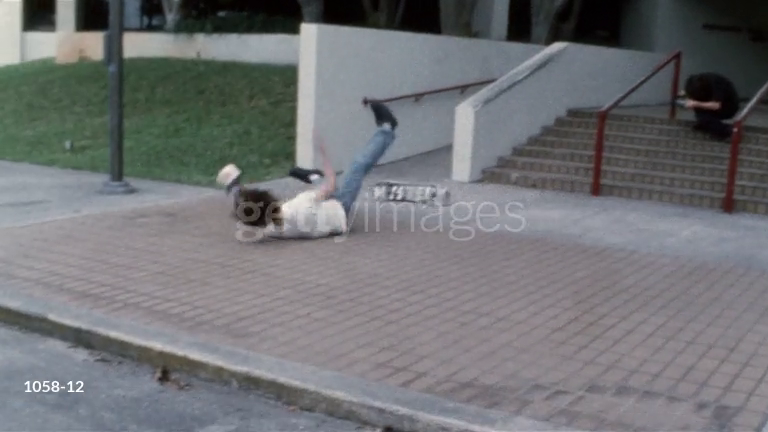


0: 384x640 1 person, 1 airplane, 193.6ms
Speed: 4.1ms preprocess, 193.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


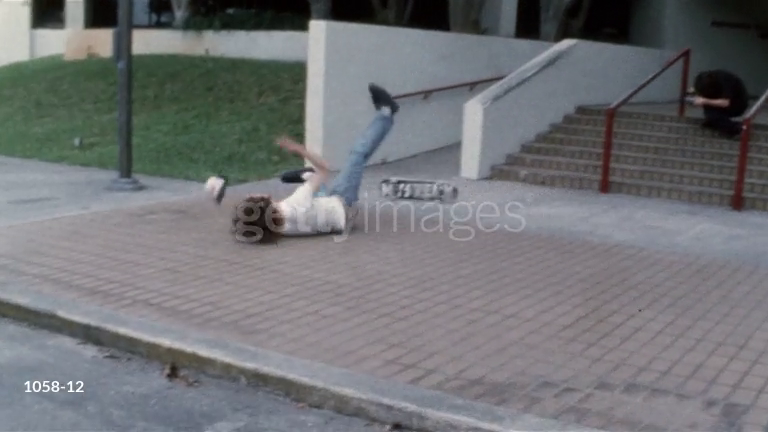


0: 384x640 1 person, 1 airplane, 205.6ms
Speed: 3.7ms preprocess, 205.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


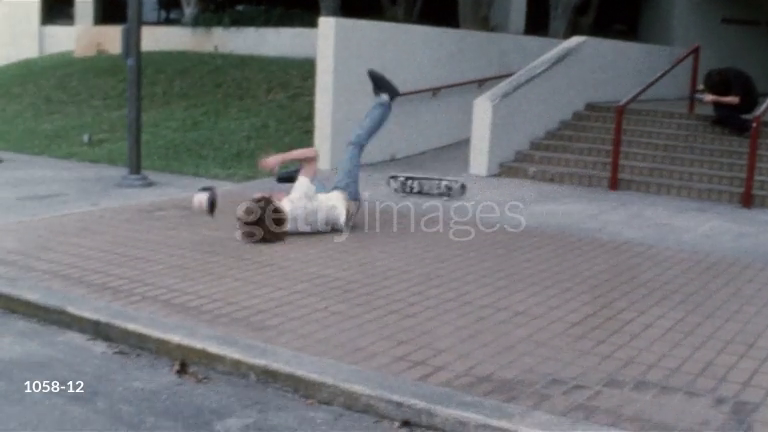


0: 384x640 1 airplane, 1 sports ball, 206.1ms
Speed: 4.1ms preprocess, 206.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


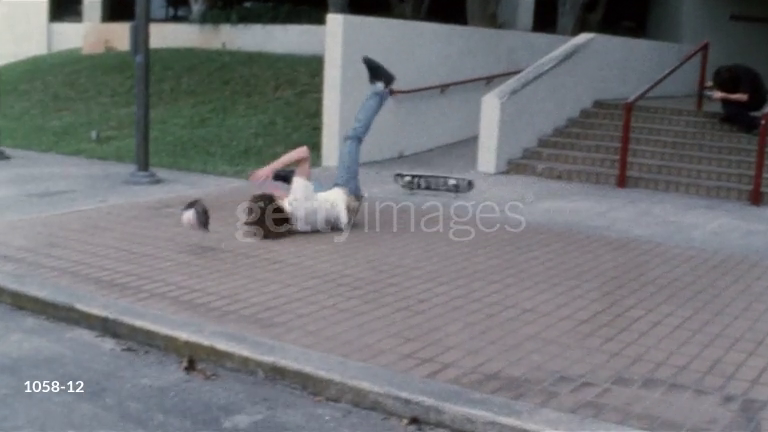


0: 384x640 1 person, 227.4ms
Speed: 6.7ms preprocess, 227.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


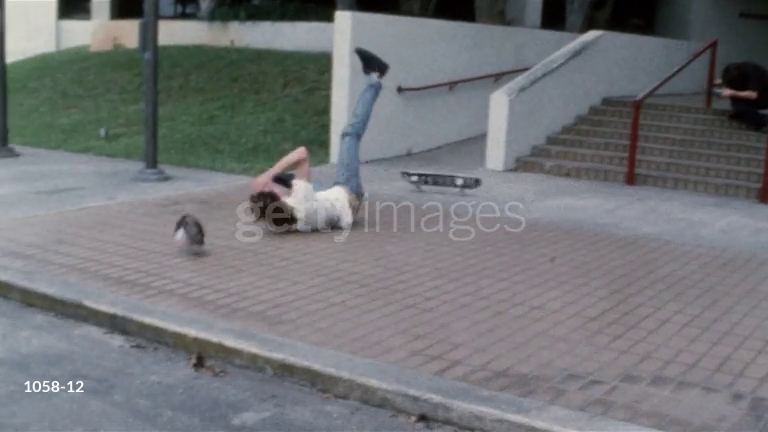


0: 384x640 1 bird, 1 sports ball, 195.1ms
Speed: 4.0ms preprocess, 195.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


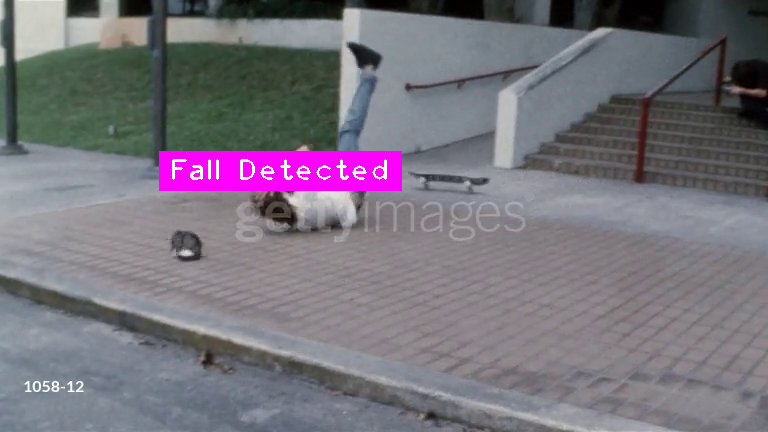


0: 384x640 (no detections), 208.8ms
Speed: 3.7ms preprocess, 208.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


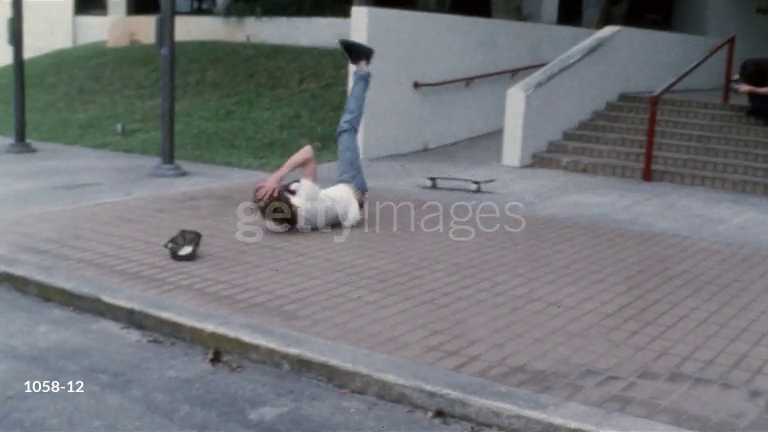


0: 384x640 2 persons, 1 sports ball, 204.4ms
Speed: 3.7ms preprocess, 204.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


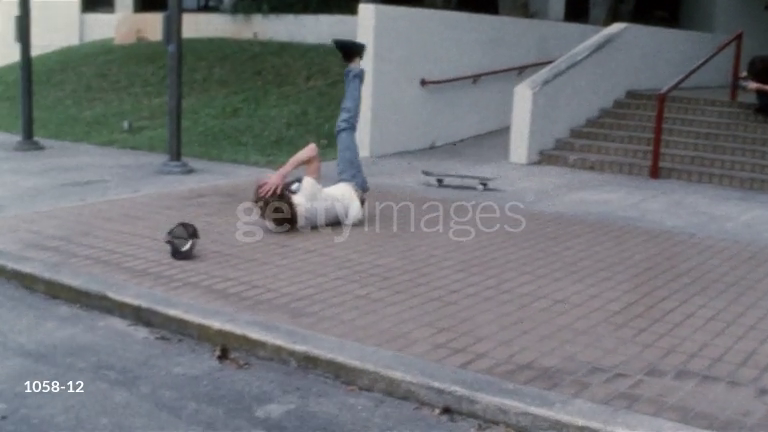


0: 384x640 1 person, 1 bird, 1 sheep, 194.5ms
Speed: 4.0ms preprocess, 194.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


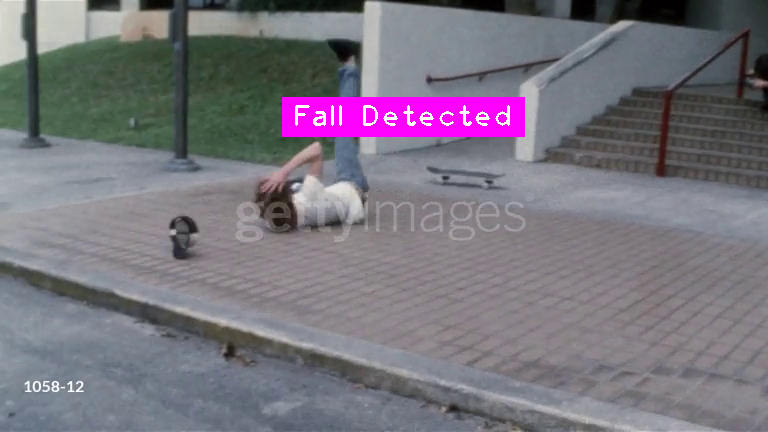


0: 384x640 1 fire hydrant, 1 sheep, 193.0ms
Speed: 3.7ms preprocess, 193.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


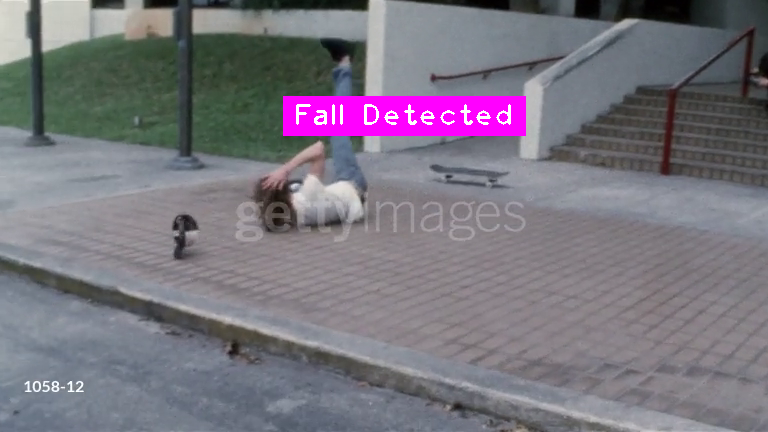


0: 384x640 1 bird, 1 dog, 1 sheep, 218.1ms
Speed: 4.2ms preprocess, 218.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


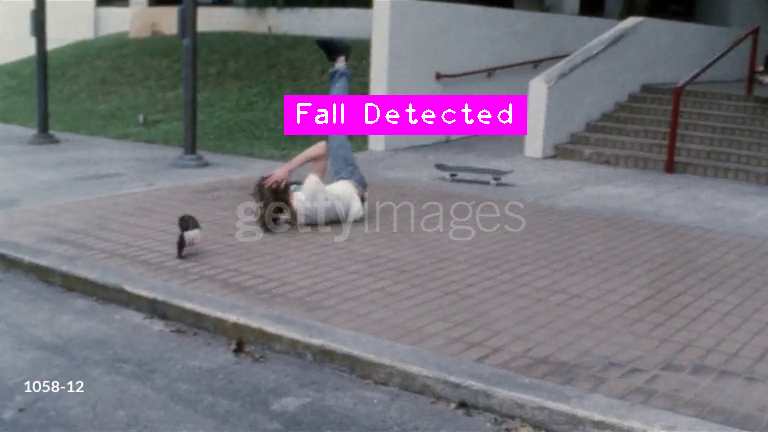


0: 384x640 1 person, 1 bird, 232.2ms
Speed: 6.8ms preprocess, 232.2ms inference, 4.5ms postprocess per image at shape (1, 3, 384, 640)


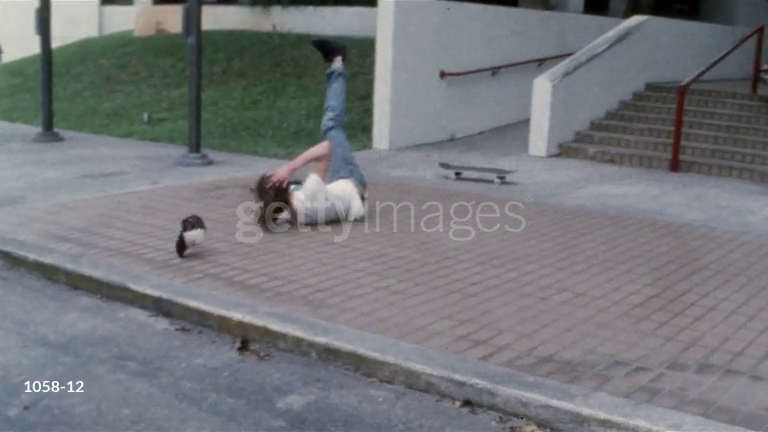


0: 384x640 2 persons, 1 bird, 245.8ms
Speed: 3.9ms preprocess, 245.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


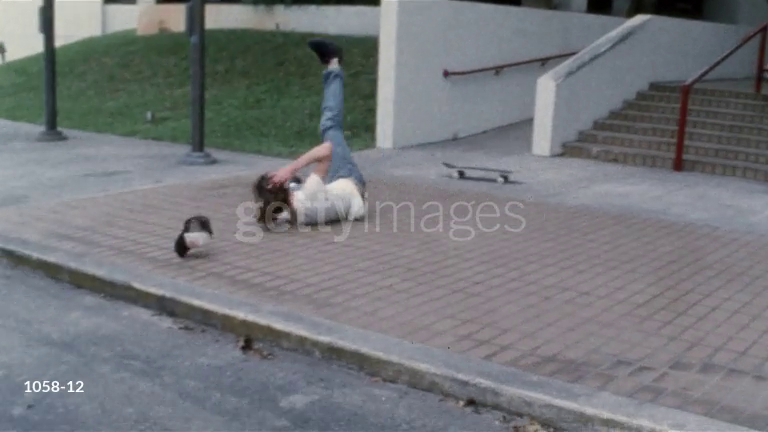


0: 384x640 1 person, 255.0ms
Speed: 5.6ms preprocess, 255.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


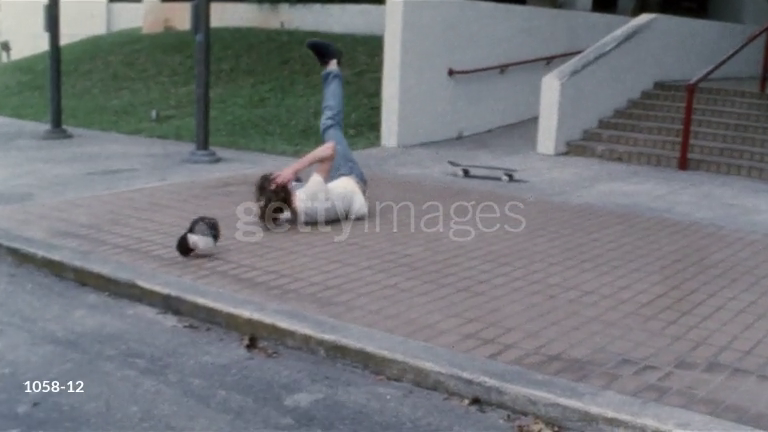


0: 384x640 1 person, 1 sports ball, 1 skateboard, 222.4ms
Speed: 3.9ms preprocess, 222.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


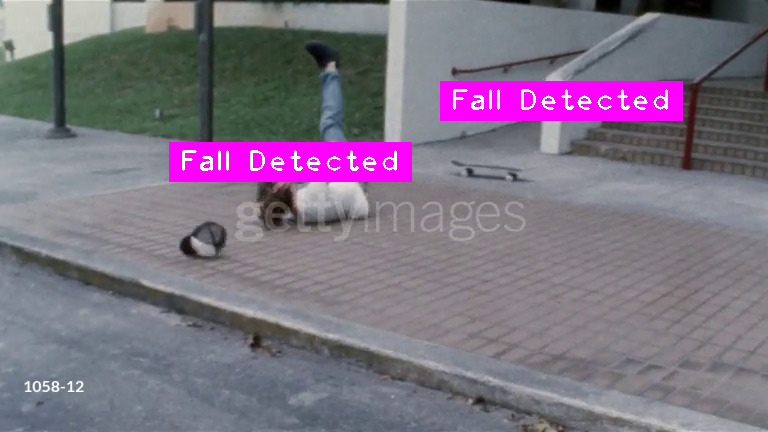


0: 384x640 1 person, 1 dog, 200.4ms
Speed: 3.8ms preprocess, 200.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


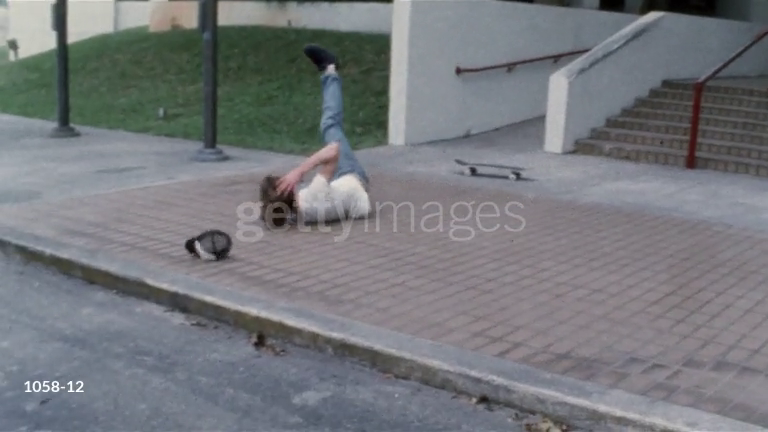


0: 384x640 1 person, 1 baseball glove, 230.7ms
Speed: 3.7ms preprocess, 230.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


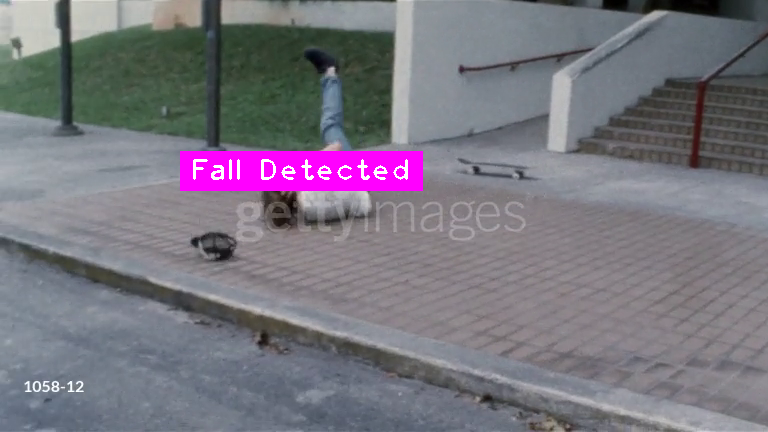


0: 384x640 1 person, 1 baseball glove, 213.9ms
Speed: 3.9ms preprocess, 213.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


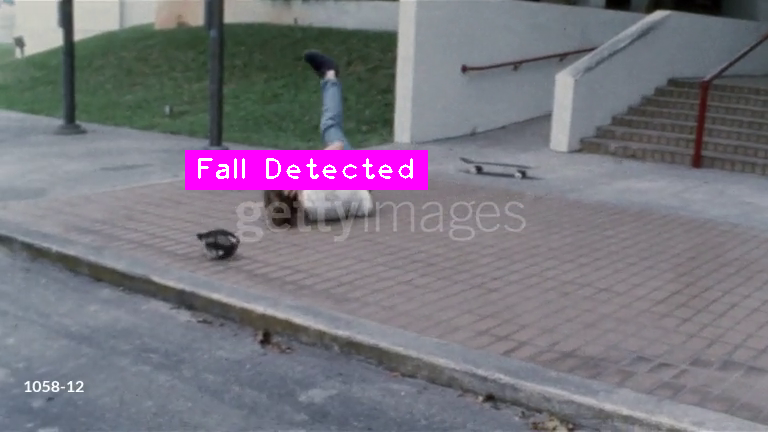


0: 384x640 2 persons, 1 backpack, 197.1ms
Speed: 3.6ms preprocess, 197.1ms inference, 6.7ms postprocess per image at shape (1, 3, 384, 640)


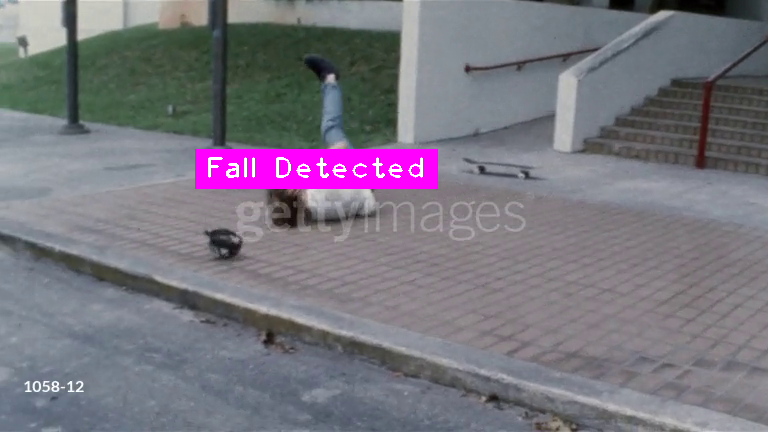


0: 384x640 2 persons, 1 backpack, 250.1ms
Speed: 3.7ms preprocess, 250.1ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 640)


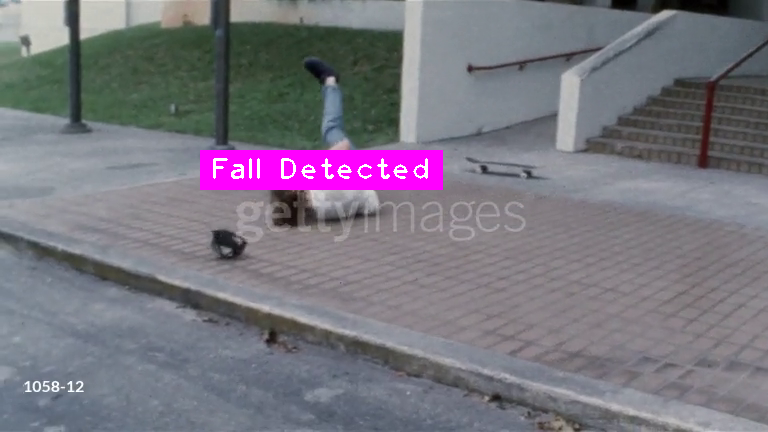


0: 384x640 1 person, 1 skateboard, 237.5ms
Speed: 6.4ms preprocess, 237.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


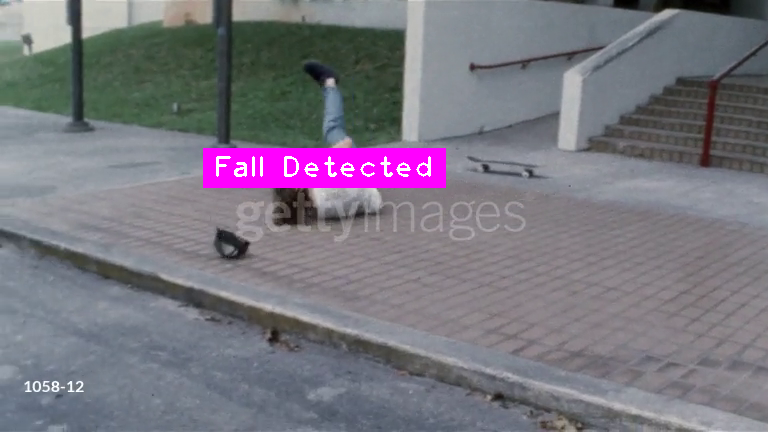

Error: Could not read frame. Breaking loop.
Fall events saved to fall_events.json.


In [ ]:
import math
import json
from datetime import datetime
from google.colab.patches import cv2_imshow


classnames = []
with open('classes.txt', 'r') as f:
    classnames = f.read().splitlines()

fall_events = []  # List to store detected falls

while True:
    ret, frame = cap.read()

    if not ret:
        print("Error: Could not read frame. Breaking loop.")
        break

    results = model(frame)

    for info in results:
        parameters = info.boxes
        for box in parameters:
            x1, y1, x2, y2 = box.xyxy[0]
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
            confidence = box.conf[0]
            class_detect = box.cls[0]
            class_detect = int(class_detect)
            class_detect = classnames[class_detect]
            conf = math.ceil(confidence * 100)

            height = y2 - y1
            width = x2 - x1
            threshold  = height - width

            if conf > 80 and class_detect == 'person':
                cvzone.cornerRect(frame, [x1, y1, width, height], l=30, rt=6)
                cvzone.putTextRect(frame, f'{class_detect}', [x1 + 8, y1 - 12], thickness=2, scale=2)

            if threshold < 0:  # Possible fall detected
                cvzone.putTextRect(frame, 'Fall Detected', [x1, y1 - 50], thickness=2, scale=2)

                # Capture fall event details
                fall_event = {
                    "timestamp": str(datetime.now()),
                    "bounding_box": [x1, y1, x2, y2],
                    "height": height,
                    "width": width,
                    "threshold": threshold
                }

                fall_events.append(fall_event)  # Add to the list

    cv2_imshow(frame)
    if cv2.waitKey(1) & 0xFF == ord('t'):
        break

cap.release()
cv2.destroyAllWindows()

# Save fall events to a file
with open("fall_events.json", "w") as file:
    json.dump(fall_events, file, indent=4)

print("Fall events saved to fall_events.json.")


**This part is dedicated to the Gemini Integration**

In [285]:
!pip install openai

In [ ]:
from openai import OpenAI

client = OpenAI(
  base_url="https://openrouter.ai/api/v1",
  api_key="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",
)

completion = client.chat.completions.create(

  model="deepseek/deepseek-r1:free",
  messages=[
    {
      "role": "user",
      "content": "What is the meaning of life?"
    }
  ]
)
print(completion.choices[0].message.content)

Okay, the user is asking about the meaning of life. That's a big question. I need to start by acknowledging that it's a complex and deeply philosophical topic. People have debated this for ages with no single answer.

First, I'll consider different perspectives. Philosophical approaches: existentialism, absurdism, religious views. Maybe mention that some find meaning through religion or spirituality, believing in a higher purpose. Others might look to existentialist ideas where individuals create their own meaning.

Then there's the scientific angle. From a biological standpoint, survival and reproduction are key, but humans often seek more than that. Psychology might suggest that meaning comes from relationships, goals, or personal growth.

Cultural differences are important too. Different societies have varying beliefs about life's purpose. Also, individual differences mean what gives one person meaning might not work for another. Maybe examples like family, creativity, helping other

In [ ]:
import json
import time
from openai import OpenAI

client = OpenAI(
    base_url="https://openrouter.ai/api/v1",
    api_key="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",
)



In [ ]:
# Load fall event data
with open("fall_events.json", "r") as f:
    fall_events = json.load(f)

fall_analysis = []

# Batching prompts for efficiency
batch_size = 5  # Adjust batch size as needed





In [ ]:

def analyze_fall_reason(event):
    """ Sends fall event details to DeepSeek and prints the response. """
    prompt = f"""
    A fall has been detected in a video surveillance system.
    - Timestamp: {event.get('timestamp', 'Unknown')}
    - Bounding Box: {event.get('bounding_box', 'N/A')}
    - Height-to-Width Ratio: {event.get('height', 'N/A')}/{event.get('width', 'N/A')}
    - Possible environmental factors: uneven floor, obstacle, slippery surface.

    Based on this data, what could be the potential reason for this fall?
    """

    try:
        response = client.chat.completions.create(
            model="deepseek/deepseek-r1:free",
            messages=[{"role": "user", "content": prompt}]
        )
        reason = response.choices[0].message.content
        print(f"Fall Detected at {event.get('timestamp', 'Unknown')}: {reason}\n")

    except Exception as e:
        print(f"Error processing event: {e}")



In [ ]:
# Load fall event data
with open("fall_events.json", "r") as f:
    fall_events = json.load(f)

# Process events in batches and print results
for i in range(0, min(len(fall_events), batch_size)):
    analyze_fall_reason(fall_events[i])
    time.sleep(1)  # Small delay to avoid rate limits

print("\nFall analysis complete.")


Fall Detected at 2025-02-22 12:40:17.126240: The detected fall can be analyzed using the provided data as follows:

### 1. **Height-to-Width Ratio (30/47 ≈ 0.64):**
   - This low ratio indicates a horizontal orientation, typical of a person lying down after a fall. Standing individuals usually have a taller bounding box (higher H/W ratio), whereas a lower ratio supports a fall event.

### 2. **Environmental Factors:**
   - **Uneven Floor:** A sudden trip or loss of balance due to irregularities (e.g., cracks, slopes, or raised surfaces) could explain the fall. This is common in outdoor areas or poorly maintained indoor spaces.
   - **Obstacle:** Striking or tripping over an object (e.g., debris, misplaced items) might have caused the fall. The bounding box location could hint at an obstacle in the walking path.
   - **Slippery Surface:** A wet/oily floor or icy patch might have caused slipping, especially in environments like kitchens, bathrooms, or outdoor walkways.

### 3. **Likely S

In [289]:
import pandas as pd

df = pd.read_json('fall_events.json')

print(df.to_string())

                    timestamp          bounding_box  height  width  threshold
0  2025-02-22 13:26:34.202891  [341, 204, 388, 234]      30     47        -17
1  2025-02-22 13:26:34.203201  [344, 214, 389, 234]      20     45        -25
2  2025-02-22 13:26:35.020164  [329, 214, 384, 239]      25     55        -30
3  2025-02-22 13:26:35.020428  [326, 205, 379, 240]      35     53        -18
4  2025-02-22 13:26:35.845527  [480, 196, 555, 265]      69     75         -6
5  2025-02-22 13:26:41.331177  [520, 171, 594, 236]      65     74         -9
6  2025-02-22 13:26:42.245978  [528, 164, 597, 229]      65     69         -4
7  2025-02-22 13:26:43.150423  [532, 157, 601, 221]      64     69         -5
8  2025-02-22 13:26:44.109514  [301, 248, 351, 278]      30     50        -20
9  2025-02-22 13:26:44.109722  [539, 148, 610, 215]      67     71         -4
10 2025-02-22 13:26:44.719037  [545, 141, 615, 205]      64     70         -6
11 2025-02-22 13:26:45.506098  [554, 134, 623, 198]      64     

In [291]:
#Loading the first 3 time events

with open("fall_events.json", "r") as f:
    data = json.load(f)

df = pd.DataFrame(data)

first_three_timeframes = df["timestamp"].head(3).tolist()

print("First 3 timeframes:", first_three_timeframes)


First 3 timeframes: ['2025-02-22 13:26:34.202891', '2025-02-22 13:26:34.203201', '2025-02-22 13:26:35.020164']


In [293]:
!pip install twilio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 43.9 MB/s eta 0:00:00


In [298]:
#Now comes twilio

from twilio.rest import Client
import time

account_sid = 'AC91bcf1ae07d547ae6d3a903356e46364'
auth_token = 'f5c6a97581eb72308f8bc28aedbe38eb'
client = Client(account_sid, auth_token)

for i in first_three_timeframes:
  message = client.messages.create(
    from_='whatsapp:+14155238886',
    body = i + " {0} no. event captured ".format(first_three_timeframes.index(i) + 1),
    to='whatsapp:+919836364257'
  )

print(Fore.LIGHTMAGENTA_EX  + "The message sending is in progess")
time.sleep(2)
print(Fore.CYAN+"The following is the message sid")
print(message.sid)

The message sending is in progess
The following is the message sid
SM353aef0b91cb8a3642aa05babfcd9dfd


In [ ]:
 # This will give index in the original list